In [1]:
!pip install rembg --quiet
!pip install onnxruntime-gpu

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.1/44.1 kB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.7/54.7 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 283.2/283.2 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 8.9 MB/s eta 0:00:00


In [2]:
import os, random, numpy as np, pandas as pd, matplotlib.pyplot as plt

import seaborn as sns
from pathlib import Path
from rembg import remove
from concurrent.futures import ThreadPoolExecutor, as_completed

import matplotlib.patches as patches
from matplotlib import cm
from PIL import Image, ImageDraw
from datetime import datetime
import cv2
import matplotlib.patches as mpatches
import math

import shutil

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim.lr_scheduler import CosineAnnealingWarmRestarts
from torch.utils.data import DataLoader, Dataset, random_split
import torchvision
from torchvision import transforms as T, models

from tqdm import tqdm

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, ConfusionMatrixDisplay, classification_report

try:
    from pytorch_grad_cam import GradCAM
except ImportError:
    !pip install grad-cam --quiet
    from pytorch_grad_cam import GradCAM

from pytorch_grad_cam.utils.image import show_cam_on_image
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 77.3 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [3]:
SEED = 42
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
torch.cuda.manual_seed_all(SEED)

torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
os.environ["PYTHONHASHSEED"] = str(SEED)

def seed_worker(worker_id):
    worker_seed = torch.initial_seed() % 2**32
    np.random.seed(worker_seed)
    random.seed(worker_seed)

g = torch.Generator()
g.manual_seed(SEED)

print(f"seed {SEED}")

seed 42


In [4]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cuda


In [5]:
from google.colab import drive
drive.mount('/content/drive')

csv_path = '/content/drive/MyDrive/ai_unict_challenge/train.csv'
train_dir = '/content/drive/MyDrive/ai_unict_challenge/train/'
test_dir = '/content/drive/MyDrive/ai_unict_challenge/test/'

Mounted at /content/drive


In [6]:
df = pd.read_csv(csv_path)

print("first five row:")
display(df.head())

print("\nInfo dataset:")
print(df.info())

first five row:


,image,x1,y1,x2,y2,class
0,00/00_000.png,144,79,271,206,0
1,00/00_001.png,201,151,328,278,0
2,00/00_002.png,136,66,263,193,0
3,00/00_003.png,161,152,288,279,0
4,00/00_004.png,138,75,265,202,0



Info dataset:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1600 entries, 0 to 1599
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   1600 non-null   object
 1   x1      1600 non-null   int64 
 2   y1      1600 non-null   int64 
 3   x2      1600 non-null   int64 
 4   y2      1600 non-null   int64 
 5   class   1600 non-null   int64 
dtypes: int64(5), object(1)
memory usage: 75.1+ KB
None


In [7]:
sample_size = 10
image_sample = df.sample(sample_size)

print(f"\nA Random Sample of {sample_size} Image:")

for index, row in image_sample.iterrows():
    img_path = os.path.join(train_dir, row['image'])
    with Image.open(img_path) as img:
          print(f"Image: {row['image']}, Type: {img.format}, Dimension: {img.size}, color: {img.mode}")


A Random Sample of 10 Image:
Image: 02/02_126.png, Type: PNG, Dimension: (350, 350), color: RGB
Image: 01/01_154.png, Type: PNG, Dimension: (350, 350), color: RGB
Image: 00/00_168.png, Type: PNG, Dimension: (350, 350), color: RGB
Image: 00/00_135.png, Type: PNG, Dimension: (350, 350), color: RGB
Image: 04/04_137.png, Type: PNG, Dimension: (350, 350), color: RGB
Image: 07/07_144.png, Type: PNG, Dimension: (350, 350), color: RGB
Image: 06/06_053.png, Type: PNG, Dimension: (350, 350), color: RGB
Image: 01/01_037.png, Type: PNG, Dimension: (350, 350), color: RGB
Image: 02/02_078.png, Type: PNG, Dimension: (350, 350), color: RGB
Image: 03/03_050.png, Type: PNG, Dimension: (350, 350), color: RGB


In [8]:
CLASS_NAMES = [
    "power strip",
    "phone",
    "scissors",
    "light bulb",
    "can",
    "glasses",
    "ball",
    "cup"
]

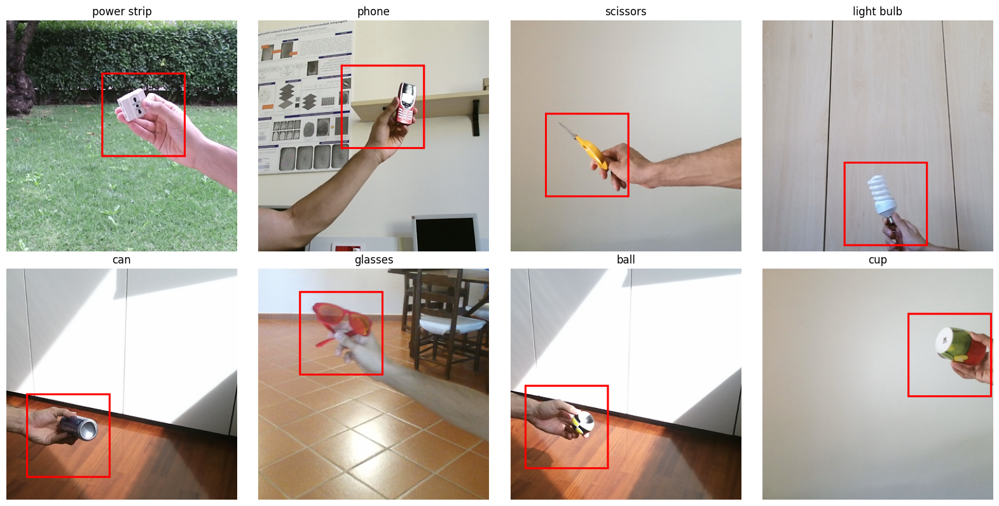

In [9]:
plt.figure(figsize=(16, 8))

for class_idx, class_name in enumerate(CLASS_NAMES):
    class_df = df[df['class'] == class_idx]
    if len(class_df) == 0:
        continue
    row = class_df.iloc[0]

    img_path = os.path.join(train_dir, row['image'])
    img = Image.open(img_path).convert("RGB")
    draw = ImageDraw.Draw(img)
    draw.rectangle([row['x1'], row['y1'], row['x2'], row['y2']], outline="red", width=3)

    plt.subplot(2, 4, class_idx+1)
    plt.imshow(img)
    plt.axis("off")
    plt.title(class_name)

plt.tight_layout()
plt.show()

Number of invalid bounding boxes found: 2
             image  x1  y1   x2   y2        bw        bh
886  04/04_086.png  -1  -1  126  126  0.362857  0.362857
482  02/02_082.png  -1  -1  126  126  0.362857  0.362857


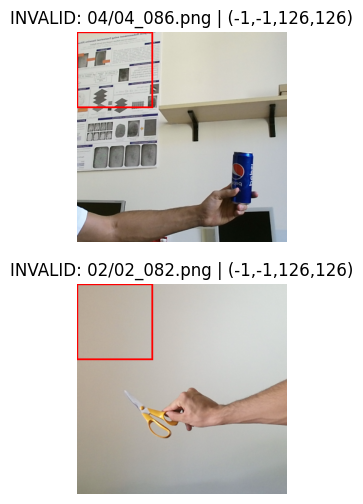

Removed the 2 images with the invalid bounding boxes.


In [10]:
img_w, img_h = 350, 350

df['x1_clean'] = df[['x1','x2']].min(axis=1)
df['y1_clean'] = df[['y1','y2']].min(axis=1)
df['x2_clean'] = df[['x1','x2']].max(axis=1)
df['y2_clean'] = df[['y1','y2']].max(axis=1)

df['x1_norm'] = df['x1_clean'] / img_w
df['y1_norm'] = df['y1_clean'] / img_h
df['x2_norm'] = df['x2_clean'] / img_w
df['y2_norm'] = df['y2_clean'] / img_h

df['bw'] = df['x2_norm'] - df['x1_norm']
df['bh'] = df['y2_norm'] - df['y1_norm']

invalid = (
    (df['x1_clean'] < 0) | (df['y1_clean'] < 0) |
    (df['x2_clean'] > img_w) | (df['y2_clean'] > img_h) |
    (df['bw'] <= 0) | (df['bh'] <= 0)
)
n_invalid = invalid.sum()
print(f"Number of invalid bounding boxes found: {n_invalid}")

if n_invalid > 0:
    bad_df = df[invalid].sample(min(5, n_invalid), random_state=SEED)
    print(bad_df[['image','x1','y1','x2','y2','bw','bh']])

    plt.figure(figsize=(15, 3*len(bad_df)))
    for i, row in enumerate(bad_df.itertuples(), 1):
        img_path = os.path.join(train_dir, row.image)

        img = Image.open(img_path).convert("RGB")
        draw = ImageDraw.Draw(img)
        draw.rectangle([row.x1_clean, row.y1_clean, row.x2_clean, row.y2_clean],
                           outline="red", width=3)
        plt.subplot(len(bad_df), 1, i)
        plt.imshow(img)
        plt.axis("off")
        plt.title(f"INVALID: {row.image} | "
                      f"({row.x1_clean},{row.y1_clean},{row.x2_clean},{row.y2_clean})")
    plt.show()

if n_invalid > 0:
    invalid_images = df.loc[invalid, 'image'].unique()
    df = df.loc[~invalid].reset_index(drop=True)
    print(f"Removed the {len(invalid_images)} images with the invalid bounding boxes.")
else:
    print("No invalid bounding boxes found.")

In [11]:
df['class'].value_counts().sort_index()

,count
class,
0,200
1,200
2,199
3,200
4,199
5,200
6,200
7,200


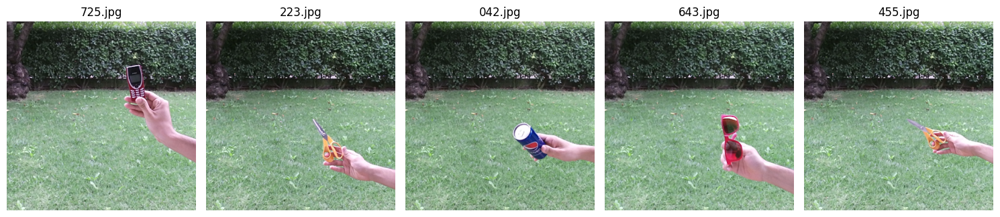

In [12]:
test_images = os.listdir(test_dir)
sample_images = random.sample(test_images, 5)

plt.figure(figsize=(15, 5))
for i, img_name in enumerate(sample_images, 1):
    img_path = os.path.join(test_dir, img_name)
    img = Image.open(img_path).convert("RGB")

    plt.subplot(1, 5, i)
    plt.imshow(img)
    plt.axis("off")
    plt.title(img_name.replace(".png",""))

plt.tight_layout()
plt.show()

In [13]:
def save_in_drive(local_path, drive_path):

    shutil.copy(local_path, drive_path)
    print(f"✅ Model weights saved to Drive at {drive_path}")

In [14]:
class CenterRegressor(nn.Module):
    def __init__(self):
        super().__init__()
        self.backbone = models.resnet18(weights=None)
        self.backbone.fc = nn.Linear(self.backbone.fc.in_features, 2)

    def forward(self, x):
        return self.backbone(x)

detector = CenterRegressor().to(device)

In [15]:
class DetectorDataset(Dataset):
    def __init__(self, df, img_dir, transform=None):
        self.df = df.reset_index(drop=True)
        self.img_dir = img_dir
        self.transform = transform

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        img_path = os.path.join(self.img_dir, row['image'])
        img = Image.open(img_path).convert("RGB")

        if self.transform:
            img = self.transform(img)
        else:
            img = T.ToTensor()(img)

        cx = (row['x1_clean'] + row['x2_clean']) / 2 / 350
        cy = (row['y1_clean'] + row['y2_clean']) / 2 / 350
        target = torch.tensor([cx, cy], dtype=torch.float32)
        return img, target

In [16]:
transform = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor()
])

train_df, val_df = train_test_split(df, test_size=0.2, random_state=SEED, stratify=df['class'])

train_ds = DetectorDataset(train_df, train_dir, transform=transform)
val_ds = DetectorDataset(val_df, train_dir, transform=transform)

train_loader = DataLoader(train_ds, batch_size=4, shuffle=True)
val_loader = DataLoader(val_ds, batch_size=4, shuffle=False)

In [17]:
def train_detector(optimizer, criterion, epochs, model=detector, train_loader=train_loader, val_loader=val_loader, device="cuda", patience=10, scheduler=None):

    best_val_loss = float('inf')
    history = {'train_loss': [], 'val_loss': []}
    best_epoch, best_train_loss = None, None
    no_improve_count = 0

    pbar = tqdm(range(epochs), desc="Training Progress", ncols=100)

    for epoch in pbar:
        model.train()
        train_loss = 0
        for imgs, targets in train_loader:
            imgs = imgs.to(device)
            targets = targets.to(device)

            optimizer.zero_grad()
            outputs = model(imgs)
            loss = criterion(outputs, targets)
            loss.backward()
            optimizer.step()

            train_loss += loss.item() * imgs.size(0)

        train_loss /= len(train_loader.dataset)

        model.eval()
        val_loss = 0
        with torch.no_grad():
            for imgs, targets in val_loader:
                imgs = imgs.to(device)
                targets = targets.to(device)
                outputs = model(imgs)
                loss = criterion(outputs, targets)
                val_loss += loss.item() * imgs.size(0)
        val_loss /= len(val_loader.dataset)

        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)

        if val_loss < best_val_loss:
            best_val_loss = val_loss
            best_train_loss = train_loss
            best_epoch = epoch + 1
            torch.save(model.state_dict(), "best_detector.pth")
            no_improve_count = 0
        else:
            no_improve_count += 1

        if scheduler is not None:
            scheduler.step(val_loss)

        pbar.set_postfix({
            "Epoch": f"{epoch+1}/{epochs}",
            "Train": f"{train_loss:.4f}",
            "Val": f"{val_loss:.4f}"
        })

        if no_improve_count >= patience:
            print(f"\n⏹️ Early stopping at epoch {epoch+1} (no improvement for {patience} epochs)")
            break

    print(f"\nBest Epoch: {best_epoch} | Val Loss: {best_val_loss:.4f} | Train Loss: {best_train_loss:.4f}")
    return history, best_epoch

In [18]:
def plot_loss(history, best_epoch):
    plt.figure(figsize=(8,5))
    plt.plot(history['train_loss'], label='Train Loss')
    plt.plot(history['val_loss'], label='Val Loss')
    plt.axvline(best_epoch-1, color='green', linestyle='--', label=f'Best Epoch {best_epoch}')
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title("Detector Training Loss")
    plt.legend()
    plt.show()

In [19]:
def evaluate_model(model, val_loader, box_size=127):

    model.eval()
    ious, maes = [], []

    with torch.no_grad():
        for imgs, targets in val_loader:
            imgs = imgs.to(device)
            targets = targets.to(device)

            preds = model(imgs)
            preds_px = preds.cpu().numpy() * 350
            targets_px = targets.cpu().numpy() * 350

            for (cx_pred, cy_pred), (cx_true, cy_true) in zip(preds_px, targets_px):

                x1p, y1p = cx_pred - box_size/2, cy_pred - box_size/2
                x2p, y2p = cx_pred + box_size/2, cy_pred + box_size/2

                x1t, y1t = cx_true - box_size/2, cy_true - box_size/2
                x2t, y2t = cx_true + box_size/2, cy_true + box_size/2

                xi1, yi1 = max(x1p, x1t), max(y1p, y1t)
                xi2, yi2 = min(x2p, x2t), min(y2p, y2t)
                inter_area = max(0, xi2 - xi1) * max(0, yi2 - yi1)

                boxA_area = (x2p - x1p) * (y2p - y1p)
                boxB_area = (x2t - x1t) * (y2t - y1t)
                union_area = boxA_area + boxB_area - inter_area

                iou = inter_area / union_area if union_area > 0 else 0
                ious.append(iou)

                mae = np.abs(cx_pred - cx_true) + np.abs(cy_pred - cy_true)
                maes.append(mae)

    mean_iou = np.mean(ious)
    mean_mae = np.mean(maes)
    print(f"📊 IoU medio: {mean_iou:.4f} | MAE medio (px): {mean_mae:.2f}")
    return mean_iou, mean_mae

In [20]:
def show_bbox_comparison(start=0, n=5):
    detector.eval()

    cols = min(n, 5)
    rows = math.ceil(n / cols)
    fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows))

    if rows == 1 and cols == 1:
        axes = [axes]
    elif rows == 1:
        axes = axes
    else:
        axes = axes.flatten()

    for ax, idx in zip(axes, range(start, start+n)):
        row = val_df.iloc[idx]
        img_path = os.path.join(train_dir, row['image'])
        img = Image.open(img_path).convert("RGB")
        draw = ImageDraw.Draw(img)

        x1, y1, x2, y2 = row['x1_clean'], row['y1_clean'], row['x2_clean'], row['y2_clean']
        draw.rectangle([x1, y1, x2, y2], outline="green", width=3)

        img_tensor = transform(img).unsqueeze(0).to(device)
        with torch.no_grad():
            cx_pred, cy_pred = detector(img_tensor)[0].cpu().numpy()
        cx_pred *= 350
        cy_pred *= 350
        half_size = (x2 - x1) / 2
        x1_pred, y1_pred = cx_pred - half_size, cy_pred - half_size
        x2_pred, y2_pred = cx_pred + half_size, cy_pred + half_size
        draw.rectangle([x1_pred, y1_pred, x2_pred, y2_pred], outline="red", width=3)

        ax.imshow(img)
        ax.axis("off")

    for j in range(n, len(axes)):
        axes[j].axis("off")

    green_patch = mpatches.Patch(color='green', label='Real')
    red_patch = mpatches.Patch(color='red', label='Predicted')
    fig.legend(handles=[green_patch, red_patch], loc='upper center', ncol=2, fontsize=12)

    plt.tight_layout()
    plt.show()

In [ ]:
optimizer = torch.optim.Adam(detector.parameters(), lr=1e-3)
criterion = nn.MSELoss()

history, best_epoch = train_detector(optimizer = optimizer, criterion = criterion, epochs = 10)

Training Progress: 100%|█████| 10/10 [03:40<00:00, 22.07s/it, Epoch=10/10, Train=0.0044, Val=0.0030]


✅ Best Epoch: 10 | Val Loss: 0.0030 | Train Loss: 0.0044


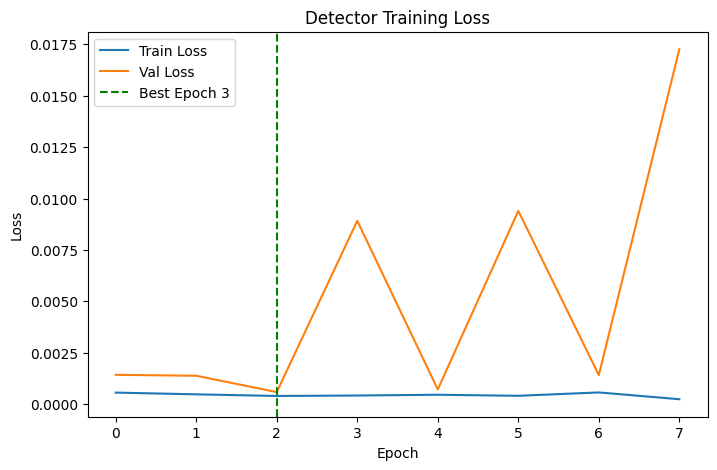

In [ ]:
plot_loss()

In [ ]:
history, best_epoch = train_detector(optimizer=optimizer, criterion=criterion, epochs=30)

Training Progress: 100%|█████| 30/30 [11:09<00:00, 22.31s/it, Epoch=30/30, Train=0.0007, Val=0.0017]


✅ Best Epoch: 29 | Val Loss: 0.0008 | Train Loss: 0.0007


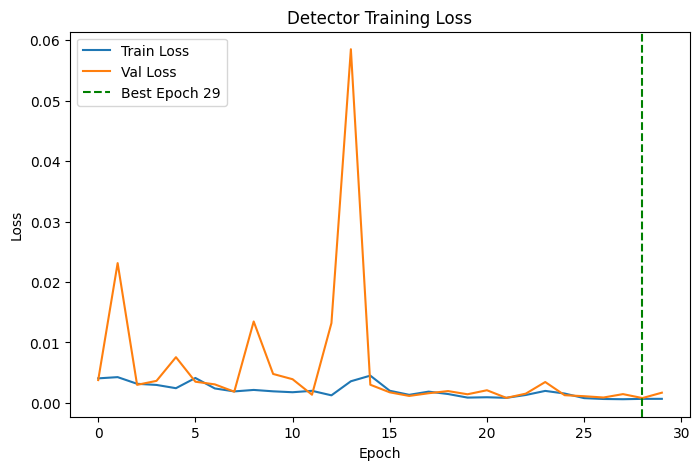

📊 IoU medio: 0.5976 | MAE medio (px): 14.62


In [ ]:
plot_loss(history = history, best_epoch = best_epoch)

best_model = CenterRegressor().to(device)
best_model.load_state_dict(torch.load("best_detector.pth", map_location=device))

mean_iou, mean_mae = evaluate_model(best_model, val_loader, box_size=50)

In [ ]:
optimizer = torch.optim.Adam(detector.parameters(), lr=1e-4)
criterion = nn.SmoothL1Loss()
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=3)

history, best_epoch = train_detector( optimizer=optimizer, criterion=criterion, epochs=40, scheduler = scheduler)

Training Progress:  78%|███▉ | 31/40 [11:21<03:17, 21.99s/it, Epoch=32/40, Train=0.0000, Val=0.0003]


⏹️ Early stopping at epoch 32 (no improvement for 20 epochs)

✅ Best Epoch: 12 | Val Loss: 0.0003 | Train Loss: 0.0000


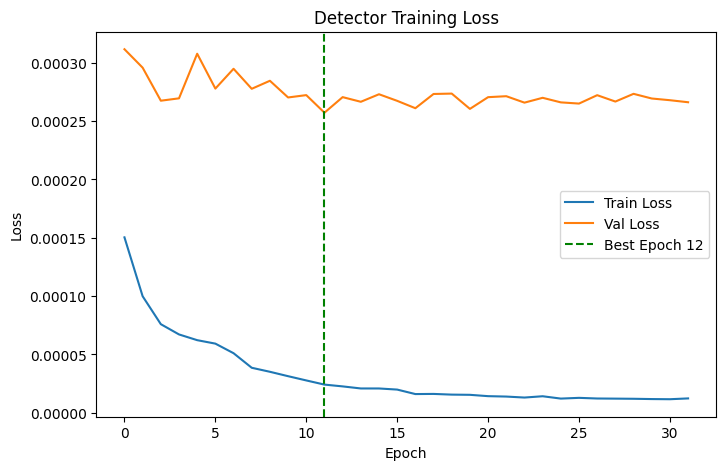

📊 IoU medio: 0.7157 | MAE medio (px): 9.83


In [ ]:
plot_loss(history = history, best_epoch = best_epoch)

best_model = CenterRegressor().to(device)
best_model.load_state_dict(torch.load("best_detector.pth", map_location=device))

mean_iou, mean_mae = evaluate_model(best_model, val_loader, box_size=50)

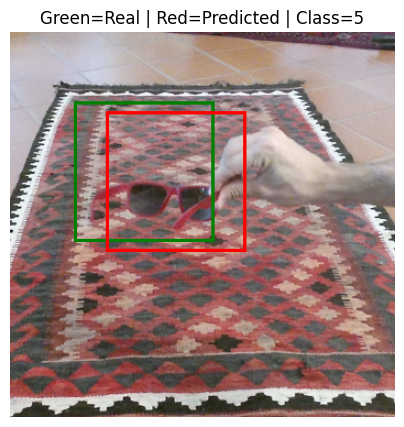

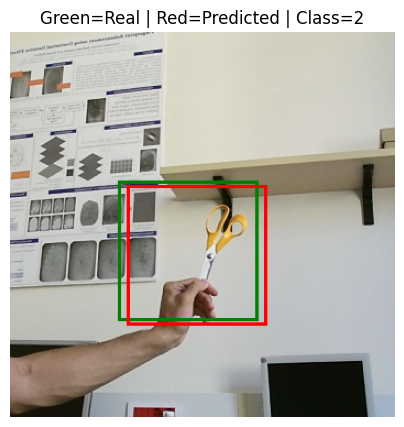

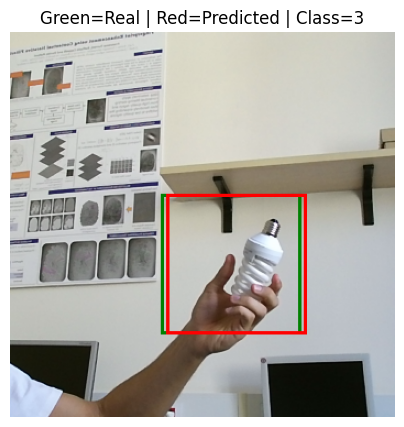

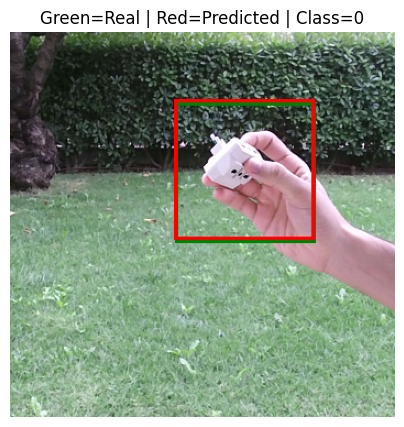

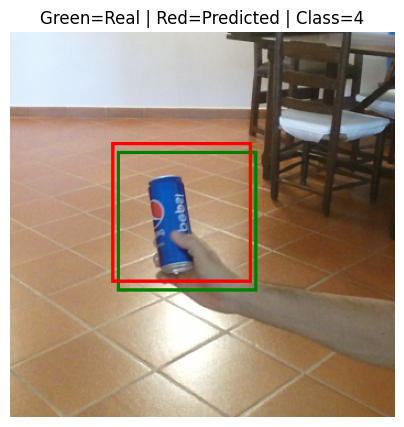

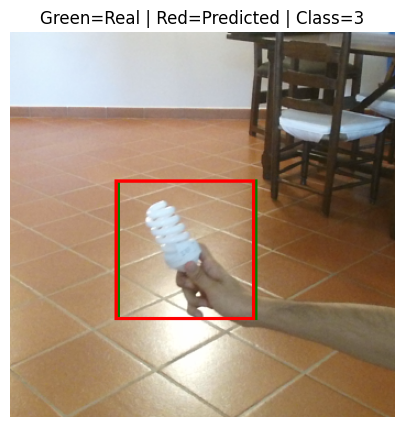

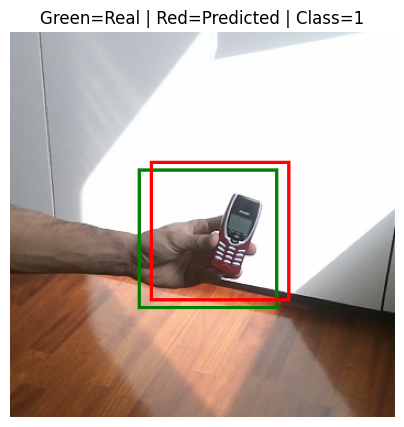

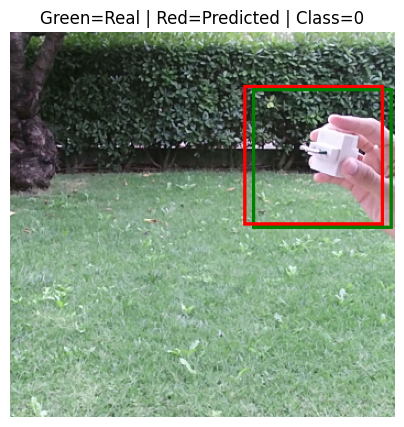

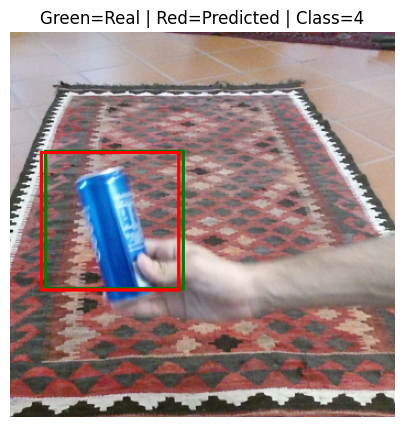

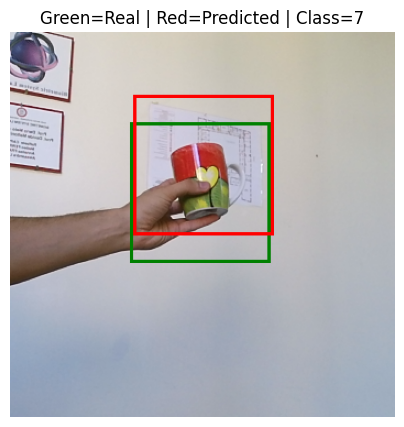

In [ ]:
show_bbox_comparison()

In [ ]:
save_in_drive(local_path = 'best_detector.pth', drive_path = '/content/drive/MyDrive/ai_unict_challenge/detector_weights.pth')

✅ Model weights saved to Drive at /content/drive/MyDrive/ai_unict_challenge/detector_weights.pth


In [ ]:
detector_model = CenterRegressor().to(device)
detector_model.load_state_dict(torch.load("/content/drive/MyDrive/ai_unict_challenge/detector_weights.pth"))

crops, labels = [], []

for _, row in tqdm(df.iterrows(), total=len(df), desc="Generating crops"):
    img_path = os.path.join(train_dir, row['image'])
    img = Image.open(img_path).convert("RGB")
    w, h = img.size

    x1b = max(int(row['x1_clean'] - 5), 0)
    y1b = max(int(row['y1_clean'] - 5), 0)
    x2b = min(int(row['x2_clean'] + 5), w)
    y2b = min(int(row['y2_clean'] + 5), h)

    real_crop = img.crop((x1b, y1b, x2b, y2b))
    real_crop = real_crop.resize((224, 224), Image.BILINEAR)
    crops.append(real_crop)
    labels.append(row['class'])

    detector_input = T.Compose([
        T.Resize((224, 224)),
        T.ToTensor()
    ])(img).unsqueeze(0).to(device)

    with torch.no_grad():
        cx_pred, cy_pred = detector_model(detector_input)[0]
        cx_pred = cx_pred.item() * w
        cy_pred = cy_pred.item() * h

    box_w = row['x2_clean'] - row['x1_clean'] + 2*5
    box_h = row['y2_clean'] - row['y1_clean'] + 2*5

    x1p = int(max(cx_pred - box_w/2, 0))
    y1p = int(max(cy_pred - box_h/2, 0))
    x2p = int(min(cx_pred + box_w/2, w))
    y2p = int(min(cy_pred + box_h/2, h))

    pred_crop = img.crop((x1p, y1p, x2p, y2p))
    pred_crop = pred_crop.resize((224, 224), Image.BILINEAR)
    crops.append(pred_crop)
    labels.append(row['class'])

print(f"Generated {len(crops)} crops with labels")

Generating crops: 100%|██████████| 1598/1598 [00:24<00:00, 65.49it/s]

Generated 3196 crops with labels


In [21]:
base_dir = '/content/drive/MyDrive/ai_unict_challenge/cropped_train'
test_base_dir = '/content/drive/MyDrive/ai_unict_challenge/cropped_test'

In [ ]:
os.makedirs(base_dir, exist_ok=True)

for t in ['real','pred']:
    for c in range(8):
        os.makedirs(os.path.join(base_dir, t, f"{c:02d}"), exist_ok=True)

for i, (img, label) in enumerate(zip(crops, labels)):

    t = 'real' if i % 2 == 0 else 'pred'

    class_idx = labels[i]
    class_dir = os.path.join(base_dir, t, f"{class_idx:02d}")

    img_name = f"{i:04d}.png"
    img.save(os.path.join(class_dir, img_name))

print("✅ Train crops saved successfully")


✅ Train crops saved successfully


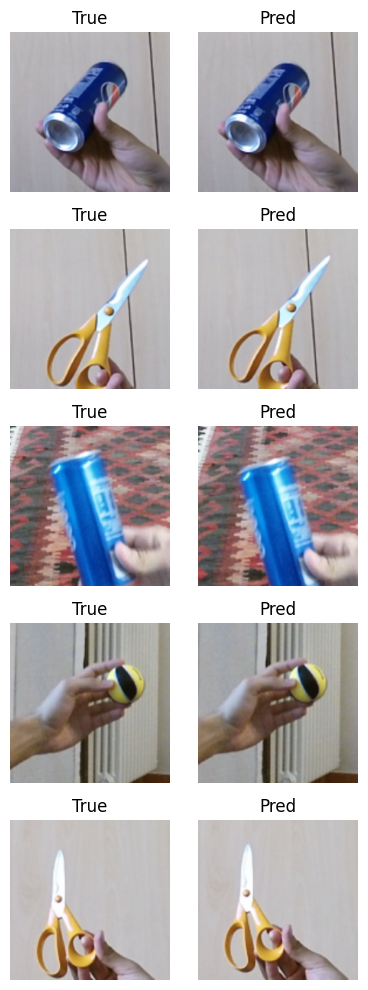

In [ ]:
n_show = 5
indices = random.sample(range(len(crops)//2), n_show)

plt.figure(figsize=(4, 2*n_show))
for i, idx in enumerate(indices):

    plt.subplot(n_show, 2, 2*i + 1)
    plt.imshow(crops[2*idx])
    plt.axis('off')
    plt.title(f"True")

    plt.subplot(n_show, 2, 2*i + 2)
    plt.imshow(crops[2*idx+1])
    plt.axis('off')
    plt.title(f"Pred")

plt.tight_layout()
plt.show()

In [ ]:
os.makedirs(test_base_dir, exist_ok=True)

for img_name in tqdm(os.listdir(test_dir), desc="Cropping test images"):
    img_path = os.path.join(test_dir, img_name)
    img = Image.open(img_path).convert("RGB")

    input_img = transform(img).unsqueeze(0).to(device)
    with torch.no_grad():
        cx, cy = detector_model(input_img).squeeze().cpu().numpy()

    cx_px = int(cx * 350)
    cy_px = int(cy * 350)
    bbox_size = 127
    x1 = max(cx_px - bbox_size//2, 0)
    y1 = max(cy_px - bbox_size//2, 0)
    x2 = min(cx_px + bbox_size//2, 350)
    y2 = min(cy_px + bbox_size//2, 350)

    crop = img.crop((x1, y1, x2, y2))
    crop = crop.resize((224, 224), Image.BILINEAR)
    crop.save(os.path.join(test_base_dir, img_name))

print("✅ Test crops saved successfully")


Cropping test images: 100%|██████████| 800/800 [00:22<00:00, 35.96it/s]

✅ Test crops saved successfully


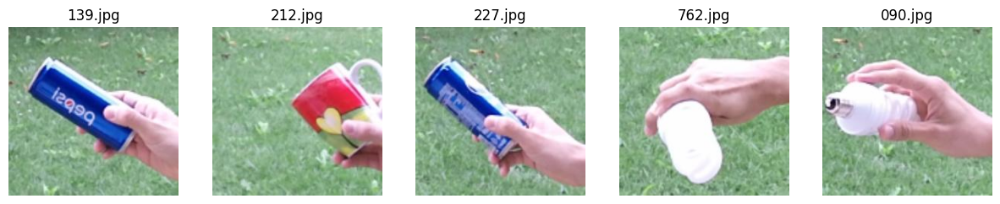

In [ ]:
all_imgs = os.listdir(test_base_dir)
sample_imgs = random.sample(all_imgs, 5)

plt.figure(figsize=(15,5))
for i, img_name in enumerate(sample_imgs):
    img_path = os.path.join(test_base_dir, img_name)
    img = Image.open(img_path).convert("RGB")

    plt.subplot(1, 5, i+1)
    plt.imshow(img)
    plt.title(img_name)
    plt.axis('off')

plt.show()

In [ ]:
random.seed(SEED)

train_dir = "/content/drive/MyDrive/ai_unict_challenge/train/"
cropped_dir = "/content/drive/MyDrive/ai_unict_challenge/cropped_train"
output_dir = "/content/drive/MyDrive/ai_unict_challenge/mixed_train"
csv_path = "/content/drive/MyDrive/ai_unict_challenge/train.csv"

n_per_source = 200
final_size = 224
bg_per_class = 50
patch_size = 50

df = pd.read_csv(csv_path)
img_w, img_h = 350, 350

df['x1_clean'] = df[['x1','x2']].min(axis=1)
df['y1_clean'] = df[['y1','y2']].min(axis=1)
df['x2_clean'] = df[['x1','x2']].max(axis=1)
df['y2_clean'] = df[['y1','y2']].max(axis=1)

invalid = (
    (df['x1_clean'] < 0) | (df['y1_clean'] < 0) |
    (df['x2_clean'] > img_w) | (df['y2_clean'] > img_h)
)
df = df.loc[~invalid].reset_index(drop=True)

for i in range(8):
    Path(os.path.join(output_dir, f"{i:02d}")).mkdir(parents=True, exist_ok=True)

In [ ]:
selected_bg_imgs = []
for cls in range(8):
    df_class = df[df['class']==cls]
    unique_imgs = df_class['image'].unique()
    selected = random.sample(list(unique_imgs), min(bg_per_class, len(unique_imgs)))
    selected_bg_imgs.extend(selected)

backgrounds = []

for img_name in tqdm(selected_bg_imgs, desc="Generating Backgrounds", ncols=100):
    img_path = os.path.join(train_dir, img_name)
    try:
        img = Image.open(img_path).convert("RGB")
        df_img = df[df['image']==img_name]

        mask = Image.new("L", img.size, 255)
        for _, row in df_img.iterrows():
            x1, y1, x2, y2 = int(row['x1_clean']), int(row['y1_clean']), int(row['x2_clean']), int(row['y2_clean'])
            mask.paste(0, (x1, y1, x2, y2))

        random_bg = Image.new("RGB", img.size, (0,0,0))
        draw = ImageDraw.Draw(random_bg)
        for y in range(0, img_h, patch_size):
            for x in range(0, img_w, patch_size):
                fill_color = (
                    random.randint(0,255),
                    random.randint(0,255),
                    random.randint(0,255)
                )
                draw.rectangle([x, y, x+patch_size, y+patch_size], fill=fill_color)

        bg_img = Image.composite(img, random_bg, mask)
        for _ in range(3):
            bg_copy = bg_img.copy()
            backgrounds.append(bg_copy.resize((final_size, final_size)))
    except:
        continue

Generating Backgrounds: 100%|█████████████████████████████████████| 400/400 [00:06<00:00, 61.58it/s]


In [ ]:
objects = []
tasks = []

for cls in range(8):
    real_path = os.path.join(cropped_dir, "real", f"{cls:02d}")
    pred_path = os.path.join(cropped_dir, "pred", f"{cls:02d}")

    real_imgs = os.listdir(real_path) if os.path.exists(real_path) else []
    pred_imgs = os.listdir(pred_path) if os.path.exists(pred_path) else []

    selected_real = random.sample(real_imgs, min(n_per_source//2, len(real_imgs)))
    remaining_pred = [x for x in pred_imgs if x not in selected_real]
    selected_pred = random.sample(remaining_pred, min(n_per_source//2, len(remaining_pred)))

    for fname in selected_real:
        tasks.append((os.path.join(real_path, fname), cls, fname))
    for fname in selected_pred:
        tasks.append((os.path.join(pred_path, fname), cls, fname))

def process_object(args):
    img_path, obj_class, fname = args
    try:
        img = Image.open(img_path).convert("RGBA")
        obj_rgba = remove(img)
        border = Image.new("RGBA", obj_rgba.size, (0,0,0,0))
        draw = ImageDraw.Draw(border)
        draw.rectangle([0,0,obj_rgba.width-1, obj_rgba.height-1], outline=(0,0,0,255))
        obj_rgba = Image.alpha_composite(obj_rgba, border)
        return (obj_rgba, obj_class, fname)
    except:
        return None

with ThreadPoolExecutor(max_workers=8) as executor:
    futures = [executor.submit(process_object, t) for t in tasks]
    for f in tqdm(as_completed(futures), total=len(futures), desc="Extracting Objects", ncols=100):
        res = f.result()
        if res:
            objects.append(res)

Extracting Objects: 100%|███████████████████████████████████████| 1600/1600 [14:11<00:00,  1.88it/s]


In [ ]:
for obj_rgba, obj_class, fname in tqdm(objects, desc="Compositing Final Images", ncols=100):
    bg_img = random.choice(backgrounds).copy().convert("RGBA")
    composed = bg_img.copy()
    composed.paste(obj_rgba, (0,0), mask=obj_rgba)
    out_path = os.path.join(output_dir, f"{obj_class:02d}", fname)
    composed.convert("RGB").save(out_path)

print("Final mixed dataset created!")

Compositing Final Images: 100%|█████████████████████████████████| 1600/1600 [00:41<00:00, 38.20it/s]

Final mixed dataset created!


In [ ]:
class MixedDataset(Dataset):
    def __init__(self, base_dir, img_size=224, transform=None):
        self.img_size = img_size
        self.transform = transform
        self.samples = []

        all_classes = sorted([c for c in os.listdir(base_dir) if c.isdigit()])

        for class_name in all_classes:
            class_idx = int(class_name)
            class_dir = os.path.join(base_dir, class_name)
            for fname in os.listdir(class_dir):
                if fname.lower().endswith(('.jpg','.png','.jpeg')):
                    img_path = os.path.join(class_dir, fname)
                    self.samples.append((img_path, class_idx))

        random.shuffle(self.samples)

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        img_path, label = self.samples[idx]
        img = Image.open(img_path).convert("RGB")

        if self.transform:
            img = self.transform(img)
        else:
            img = T.Compose([
                T.Resize((self.img_size, self.img_size)),
                T.ToTensor()
            ])(img)

        return img, label

In [ ]:
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

train_transform = T.Compose([
    T.Resize((224,224)),
    T.RandomHorizontalFlip(p=0.5),
    T.RandomVerticalFlip(p=0.2),
    T.RandomRotation(25),
    T.RandomAffine(
        degrees=20,
        translate=(0.2, 0.2),
        scale=(0.8, 1.2),
        shear=10
    ),
    T.ColorJitter(brightness=0.4, contrast=0.4, saturation=0.4, hue=0.1),
    T.GaussianBlur(kernel_size=(3,7), sigma=(0.1, 2.0)),
    T.ToTensor(),
    T.Lambda(lambda x: x + 0.05*torch.randn_like(x)),
    T.RandomErasing(p=0.7, scale=(0.02,0.2), ratio=(0.3,3.3), value='random', inplace=False),
    T.Normalize(mean, std)
])

val_transform = T.Compose([
    T.Resize((224,224)),
    T.ToTensor(),
    T.Normalize(mean, std)
])

test_transform = T.Compose([
    T.Resize((224,224)),
    T.ToTensor(),
    T.Normalize(mean, std)
])

In [ ]:
full_dataset = MixedDataset(
    '/content/drive/MyDrive/ai_unict_challenge/mixed_train/',
    transform=None
)

train_size = int(0.8 * len(full_dataset))
val_size = len(full_dataset) - train_size
train_dataset_raw, val_dataset_raw = random_split(full_dataset, [train_size, val_size])

train_dataset = train_dataset_raw
train_dataset.dataset.transform = train_transform

val_dataset = val_dataset_raw
val_dataset.dataset.transform = val_transform

train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True, num_workers=2)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False, num_workers=2)

In [ ]:
class Classifier(nn.Module):
    def __init__(self, n_classes=8):
        super().__init__()
        self.model = models.resnet18(weights=None)
        self.model.fc = nn.Linear(self.model.fc.in_features, n_classes)

    def forward(self, x):
        return self.model(x)

classifier = Classifier(n_classes=8).to(device)

In [ ]:
def train_classifier(model, train_loader, val_loader, criterion, optimizer,
                     epochs=20, device="cuda", scheduler=None, patience=10):

    history = {'train_loss': [], 'val_loss': [], 'train_acc': [], 'val_acc': []}
    best_val_loss = float('inf')
    trigger_times = 0

    pbar = tqdm(range(epochs), desc="Classifier Training", ncols=100)

    for epoch in pbar:

        model.train()
        running_loss, correct, total = 0, 0, 0
        for imgs, labels in train_loader:
            imgs, labels = imgs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(imgs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * imgs.size(0)
            _, preds = outputs.max(1)
            correct += (preds == labels).sum().item()
            total += labels.size(0)
        train_loss = running_loss / total
        train_acc = correct / total

        model.eval()
        running_loss, correct, total = 0, 0, 0
        with torch.no_grad():
            for imgs, labels in val_loader:
                imgs, labels = imgs.to(device), labels.to(device)
                outputs = model(imgs)
                loss = criterion(outputs, labels)
                running_loss += loss.item() * imgs.size(0)
                _, preds = outputs.max(1)
                correct += (preds == labels).sum().item()
                total += labels.size(0)
        val_loss = running_loss / total
        val_acc = correct / total

        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_acc'].append(train_acc)
        history['val_acc'].append(val_acc)

        if val_loss < best_val_loss:
            best_val_loss = val_loss
            best_train_loss = train_loss
            best_train_acc = train_acc
            best_val_acc = val_acc
            best_epoch = epoch + 1
            torch.save(model.state_dict(), "best_classifier.pth")
            trigger_times = 0
        else:
            trigger_times += 1

        if scheduler is not None:
            if isinstance(scheduler, torch.optim.lr_scheduler.ReduceLROnPlateau):
                scheduler.step(val_loss)
            else:
                scheduler.step()

        if patience is not None and trigger_times >= patience:
            print(f"\nEarly stopping at epoch {epoch+1}")
            break

        pbar.set_postfix({
            "Epoch": f"{epoch+1}/{epochs}",
            "Val Loss": f"{val_loss:.4f}"
        })

    print(f"\nBest Epoch: {best_epoch} | Val Loss: {best_val_loss:.4f} | "
          f"Train Loss: {best_train_loss:.4f} | Val Acc: {best_val_acc:.4f} | Train Acc: {best_train_acc:.4f}")

    return history

In [ ]:
def plot_history(history):
    epochs = range(1, len(history['train_loss'])+1)

    plt.figure(figsize=(14,5))

    plt.subplot(1,2,1)
    plt.plot(epochs, history['train_loss'], label='Train Loss')
    plt.plot(epochs, history['val_loss'], label='Val Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training/Validation Loss')
    plt.legend()

    plt.subplot(1,2,2)
    plt.plot(epochs, history['train_acc'], label='Train Acc')
    plt.plot(epochs, history['val_acc'], label='Val Acc')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.title('Training/Validation Accuracy')
    plt.legend()

    plt.show()

In [ ]:
def show_prediction(model, dataset, n_samples=3):
    model.eval()
    idxs = random.sample(range(len(dataset)), n_samples)
    plt.figure(figsize=(12, 4*n_samples))

    for i, idx in enumerate(idxs):
        img, label = dataset[idx]
        input_tensor = img.unsqueeze(0).to(device)

        with torch.no_grad():
            output = model(input_tensor)
            pred = output.argmax(dim=1).item()

        img_disp = img.cpu().permute(1,2,0)
        img_disp = img_disp * torch.tensor(std).view(1,1,3) + torch.tensor(mean).view(1,1,3)
        img_disp = img_disp.numpy()
        img_disp = np.clip(img_disp, 0, 1)

        plt.subplot(n_samples, 2, 2*i+1)
        plt.imshow(img_disp)
        plt.title(f"Label: {label}")
        plt.axis('off')

        plt.subplot(n_samples, 2, 2*i+2)
        plt.bar(range(output.shape[1]), output.cpu().numpy().flatten())
        plt.title(f"Prediction: {pred}")
        plt.xticks(range(output.shape[1]))

    plt.show()

In [ ]:
optimizer = torch.optim.Adam(classifier.parameters(), lr=1e-3)
criterion = nn.CrossEntropyLoss()
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=3)

In [ ]:
history = train_classifier(classifier, train_loader, val_loader,
                           criterion, optimizer, device=device,
                           scheduler=scheduler)

Classifier Training: 100%|████████████| 20/20 [03:14<00:00,  9.71s/it, Epoch=20/20, Val Loss=0.1741]


Best Epoch: 14 | Val Loss: 0.1654 | Train Loss: 0.1194 | Val Acc: 0.9531 | Train Acc: 0.9656


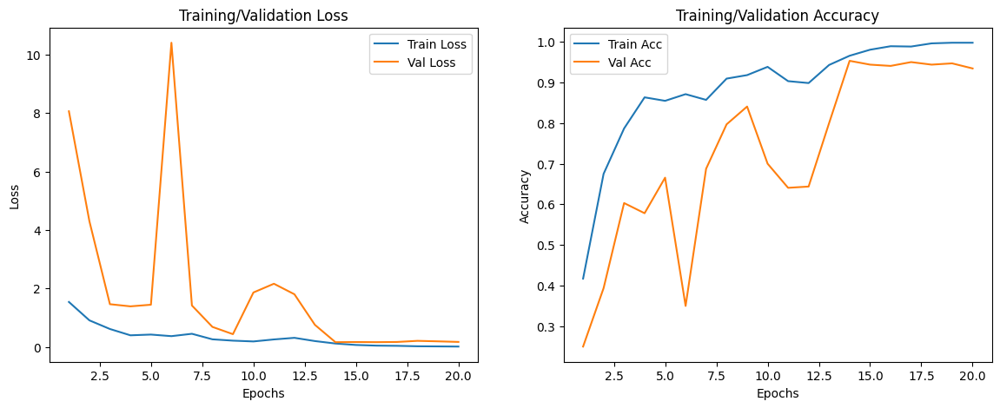

In [ ]:
plot_history(history)

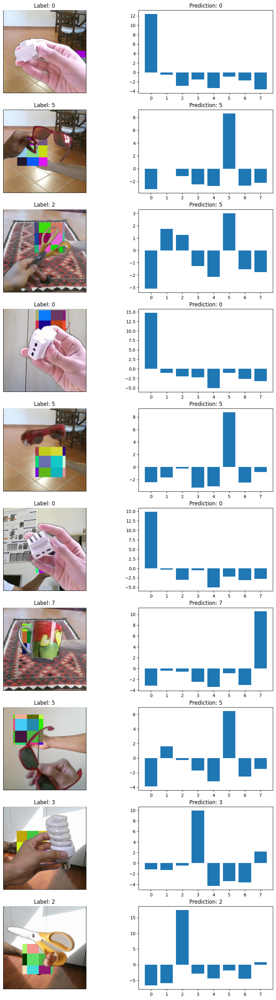

In [ ]:
show_prediction(classifier, val_dataset, n_samples=10)

In [ ]:
save_in_drive(local_path = 'best_classifier.pth', drive_path = '/content/drive/MyDrive/ai_unict_challenge/classifier_weights.pth')

✅ Model weights saved to Drive at /content/drive/MyDrive/ai_unict_challenge/classifier_weights.pth


In [ ]:
class TestDataset(Dataset):
    def __init__(self, img_dir, transform=None):
        self.img_dir = img_dir
        self.transform = transform
        self.images = sorted(os.listdir(img_dir), key=lambda x: int(x.split(".")[0]))

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_name = self.images[idx]
        img_path = os.path.join(self.img_dir, img_name)
        img = Image.open(img_path).convert("RGB")
        if self.transform:
            img = self.transform(img)
        return img, img_name

In [ ]:
test_dataset = TestDataset(test_base_dir, transform=test_transform)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

In [ ]:
classifier = Classifier(n_classes=8).to(device)
classifier.load_state_dict(torch.load("/content/drive/MyDrive/ai_unict_challenge/classifier_weights.pth", map_location=device))
classifier.eval()

preds = []
img_names = []

with torch.no_grad():
    for imgs, names in test_loader:
        imgs = imgs.to(device)
        outputs = classifier(imgs)
        predicted = torch.argmax(outputs, dim=1).cpu().numpy()
        preds.extend(predicted)
        img_names.extend(names)

df_preds = pd.DataFrame({"image": img_names, "class": preds})
df_preds.to_csv("/content/drive/MyDrive/ai_unict_challenge/cropped_test_predictions.csv", index=False)
print("Predictions saved in Drive")

Predictions saved in Drive


In [ ]:
def denormalize(img_tensor):

    img = img_tensor.cpu().permute(1,2,0).numpy()
    img = img * std + mean
    return np.clip(img, 0, 1)

class GradCAM:
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer
        self.gradients = None
        self.activations = None
        self.hook_handles = []
        self._register_hooks()

    def _register_hooks(self):
        def forward_hook(module, input, output):
            self.activations = output.detach()

        def backward_hook(module, grad_in, grad_out):
            self.gradients = grad_out[0].detach()

        self.hook_handles.append(self.target_layer.register_forward_hook(forward_hook))
        self.hook_handles.append(self.target_layer.register_backward_hook(backward_hook))

    def remove_hooks(self):
        for handle in self.hook_handles:
            handle.remove()

    def generate(self, input_tensor, class_idx=None):
        self.model.zero_grad()
        output = self.model(input_tensor)

        if class_idx is None:
            class_idx = output.argmax(dim=1).item()

        target = output[:, class_idx]
        target.backward()

        grads = self.gradients
        activs = self.activations

        weights = grads.mean(dim=(2, 3), keepdim=True)
        cam = (weights * activs).sum(dim=1, keepdim=True)

        cam = torch.relu(cam)
        cam = cam.squeeze().cpu().numpy()
        cam = cv2.resize(cam, (input_tensor.size(-1), input_tensor.size(-2)))
        cam = (cam - cam.min()) / (cam.max() - cam.min() + 1e-8)

        return cam, class_idx

def show_gradcam(model, dataset, indices, device="cuda"):

    if not isinstance(indices, (list, tuple)):
        indices = list(indices)

    model.eval()
    gradcam = GradCAM(model, model.model.layer4)

    plt.figure(figsize=(8, len(indices)*4))
    for i, idx in enumerate(indices):
        img, label = dataset[idx]

        input_tensor = img.unsqueeze(0).to(device)

        cam, pred_class = gradcam.generate(input_tensor)

        img_denorm = denormalize(img)

        heatmap = cv2.applyColorMap(np.uint8(255*cam), cv2.COLORMAP_JET)
        heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)
        overlay = np.clip(0.5*img_denorm + 0.5*heatmap/255.0, 0, 1)

        plt.subplot(len(indices), 2, 2*i+1)
        plt.imshow(img_denorm)
        plt.title(f"Idx {idx} | True: {label}")
        plt.axis("off")

        plt.subplot(len(indices), 2, 2*i+2)
        plt.imshow(overlay)
        plt.title(f"Pred: {pred_class}")
        plt.axis("off")

    plt.tight_layout()
    plt.show()
    gradcam.remove_hooks()


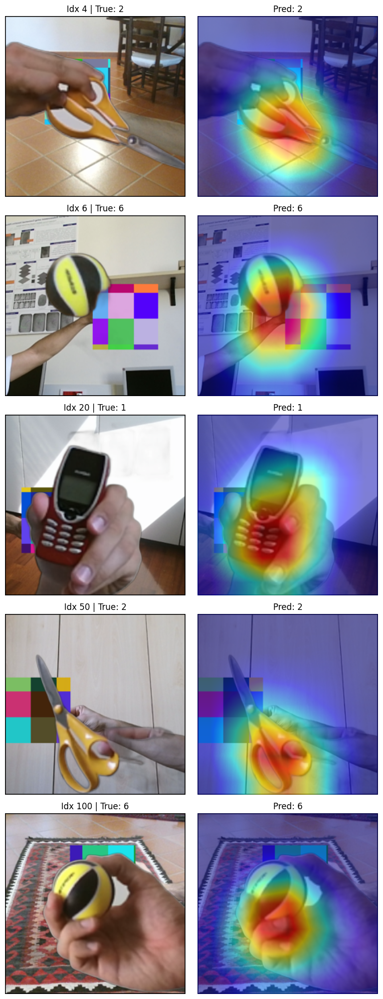

In [ ]:
show_gradcam(classifier, val_dataset, [4, 6, 20, 50, 100], device=device)

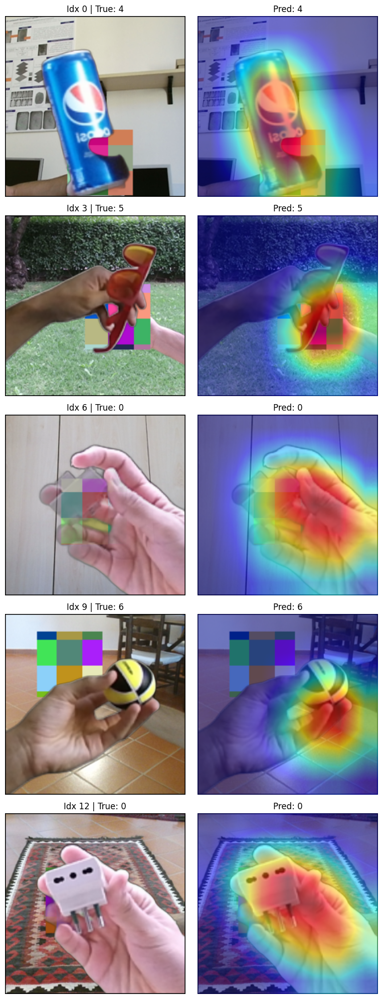

In [ ]:
show_gradcam(classifier, train_dataset, range(0, 15, 3), device=device)

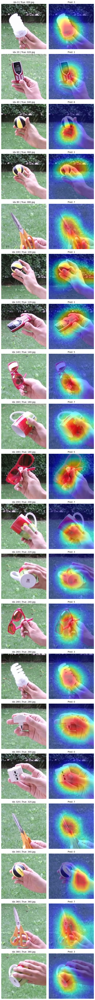

In [ ]:
show_gradcam(classifier, test_dataset, range(0, 400, 20), device=device)